# Pro Cam Scan

## Setup
Notes for setting up on a GCE instance (Ubuntu 16.04). This notebook wont run with the free colab instance

### Connect to GCE instance 

```ssh -i $HOME/.ssh/google_compute_engine jongejan@<IP> -L 8888:localhost:8888 ```

### Setup dependencies:
```
wget https://repo.anaconda.com/archive/Anaconda3-5.2.0-Linux-x86_64.sh
bash Anaconda3-5.2.0-Linux-x86_64.sh
pip install jupyter_http_over_ws
jupyter serverextension enable --py jupyter_http_over_ws
gcloud init
```

### Start
```jupyter notebook   --NotebookApp.allow_origin='https://colab.research.google.com'   --no-browser  --port=8888```



### Upload data:
```gsutil -m rsync -r SharedData/ gs://lightleaks/todaysart/```

Interesting things I noticed:
- Color is a subtle indicator of edge reflections.
- It should be possible to know that the gray area between white and black belongs to both white and black.
- Highpass is only helpful for calculating the confidence, not useful for building the map.

In [3]:
#@title Settings { run: "auto" }

# SETTINGS
proj_width = 7680 #@param {type:"integer"}
proj_height = 1080 #@param {type:"integer"}

bucket = 'lightleaks'
bucket_folder = "todaysart" #@param ["music_center", "todaysart"] {allow-input: true}

LOCAL = True

if LOCAL:
    data_dir = '/home/jovyan/SharedData'
else:
    data_dir = '/tmp/data/'+bucket_folder

In [4]:
# !sudo apt-get -qq install -y libsm6 libxext6 && pip install -q -U opencv-python
# !sudo apt-get install -y libturbojpeg  libxrender-dev
# !pip install jpeg4py msgpack numpy-indexed

# !rm -rf utils
# !git clone https://github.com/kylemcdonald/python-utils utils
import sys

# Utils is added at this path in docker image:
sys.path.append('/home/jovyan/')

import cv2
from utils.imutil import *
from utils.progress import *
# from utils.show_array import *
from matplotlib import pyplot as plt
from itertools import product
import glob 
from scipy import ndimage
from multiprocessing import Pool, cpu_count
from numba import jit


# !pip install mpld3
# import matplotlib.pyplot as plt, mpld3
%matplotlib inline

# mpld3.


In [5]:

def sync_data():
    if not LOCAL:
        !mkdir -p {data_dir}
        !gsutil -m rsync -r -d 'gs://{bucket}/{bucket_folder}' /tmp/data/{bucket_folder}

sync_data()

print("Scans:")
!ls -d {data_dir}/scan-*/

Scans:
/home/jovyan/SharedData/scan-1822/  /home/jovyan/SharedData/scan-2319/
/home/jovyan/SharedData/scan-1827/  /home/jovyan/SharedData/scan-2329/
/home/jovyan/SharedData/scan-1831/  /home/jovyan/SharedData/scan-2338/
/home/jovyan/SharedData/scan-1836/  /home/jovyan/SharedData/scan-2346/
/home/jovyan/SharedData/scan-1848/  /home/jovyan/SharedData/scan-2357/
/home/jovyan/SharedData/scan-1853/  /home/jovyan/SharedData/scan-2358/
/home/jovyan/SharedData/scan-1858/


## Image loading

In [4]:
# !ls -d {data_dir}/scan-*/
_scan_name = 'scan-1836' #@param  {type: "string"}
# !mkdir -p /tmp/scan/
# !gsutil -m -q cp -r 'gs://{bucket}/{scan_name}' /tmp/scan/

def job(fn):
#     print(fn)
    # faster to do conversion to gray here (in parallel) rather than later
    data = imread(fn).mean(axis=2)
    
    lowpass = cv2.GaussianBlur(data,(51,51),0)
    #     lowpass = ndimage.gaussian_filter(data, 300)
    gauss_highpass = data - lowpass
    gauss_highpass = gauss_highpass / 2
    gauss_highpass = gauss_highpass + 128
    gauss_highpass = np.clip(gauss_highpass, 0, 255)
    gauss_highpass = np.abs(gauss_highpass)
#     print(gauss_highpass.min(), gauss_highpass.max())
    return gauss_highpass.astype(np.uint8)

def load_scan(__scan_name):
    global scan_name, cam_mask_image, normal_horizontal, inverse_horizontal, normal_vertical, inverse_vertical, reference_image, min_image
    scan_name = __scan_name
    count_vertical_files_normal = len(glob.glob1(os.path.join(data_dir,scan_name,'cameraImages/vertical/normal'),"*.jpg"))
    count_vertical_files_inverse = len(glob.glob1(os.path.join(data_dir,scan_name,'cameraImages/vertical/inverse'),"*.jpg"))
    count_horizontal_files_normal = len(glob.glob1(os.path.join(data_dir,scan_name,'cameraImages/horizontal/normal'),"*.jpg"))
    count_horizontal_files_inverse = len(glob.glob1(os.path.join(data_dir,scan_name,'cameraImages/horizontal/inverse'),"*.jpg"))
    assert count_vertical_files_normal > 0
    assert count_vertical_files_normal == count_vertical_files_inverse
    assert count_horizontal_files_normal == count_horizontal_files_inverse


    # cam_mask_image = 
    try:
        cam_mask_image = imread(os.path.join(data_dir,scan_name,"mask.png"))
        if len(cam_mask_image.shape) == 3:
            cam_mask_image = cam_mask_image.mean(axis=2)
    except:
        cam_mask_image = None
        print("No mask loadeed")

    filenames = []
    descriptions = []
    for direction, n in (('vertical', count_vertical_files_normal), ('horizontal', count_horizontal_files_normal)):
        for parity in ('normal', 'inverse'):
#     direction = 'vertical'
#     parity = 'normal'
#     n = count_vertical_files_normal
            cur = [(direction, parity, i) for i in range(n)]
            descriptions.extend(cur)
            filenames.extend([os.path.join(data_dir,scan_name,'cameraImages/{}/{}/{}.jpg'.format(*e)) for e in cur])

#   print(count_vertical_files_normal, filenames)
#   images = progress_parallel(job, filenames)
    print("List images, loading and pre-processing now")
    with Pool(processes=cpu_count()) as pool:
        images = pool.map(job, filenames)
    print("Pre-processing finished")
    # Load images in right buckets

    normal_horizontal = np.asarray([i for i,d in zip(images, descriptions) if d[0] == 'horizontal' and d[1] == 'normal'])
    inverse_horizontal = np.asarray([i for i,d in zip(images, descriptions) if d[0] == 'horizontal' and d[1] == 'inverse'])
    normal_vertical = np.asarray([i for i,d in zip(images, descriptions) if d[0] == 'vertical' and d[1] == 'normal'])
    inverse_vertical = np.asarray([i for i,d in zip(images, descriptions) if d[0] == 'vertical' and d[1] == 'inverse'])

    images_raw = np.asarray([i for i in images])
    min_image = np.amin(images_raw, axis=0)
    reference_image = cv2.equalizeHist(min_image)

    print("Horizontal count: %d" % len(normal_horizontal))
    print("Vertical count: %d" % len(normal_vertical))

# load_scan(_scan_name)
# imshow(reference_image)

In [5]:
# imshow(normal_horizontal[4])
# def job(fn):
# #     print(fn)
#     # faster to do conversion to gray here (in parallel) rather than later
#     data = imread(fn).mean(axis=2)
#     lowpass = cv2.GaussianBlur(data,(301,301),0)
# #     lowpass = ndimage.gaussian_filter(data, 31)
#     gauss_highpass = data - lowpass
#     gauss_highpass = gauss_highpass / 2
#     gauss_highpass = gauss_highpass + 128
#     gauss_highpass = np.clip(gauss_highpass, 0, 255)
# #     gauss_highpass = np.abs(gauss_highpass)
#     print(gauss_highpass.min(), gauss_highpass.max())
#     return gauss_highpass.astype(np.uint8)

# imshow(job(os.path.join(data_dir,scan_name,'cameraImages/horizontal/inverse/3.jpg')), fmt='jpg')

In [6]:
fig, ax = plt.subplots(nrows=2, ncols=len(diff_code_vertical), figsize=(25, 3), sharey=True)
for i, d in enumerate(diff_code_horizontal):
    ax[0][i].hist(np.abs(d.flatten()), bins=100)
    ax[0][i].set_yscale('log')
  
for i, d in enumerate(diff_code_vertical):
    ax[1][i].hist(np.abs(d.flatten()), bins=100)
    ax[1][i].set_yscale('log')
  
ax[0][0].set_title('Low frequency confidence')
ax[0][-1].set_title('High frequency confidence')

plt.show()

NameError: name 'diff_code_vertical' is not defined

In [18]:
def calculate_difference():
    global diff_code_horizontal, diff_code_vertical, confidence_horizontal, confidence_vertical
    global confidence
    # Calculate differeence
    diff_code_horizontal = normal_horizontal.astype(np.float32) - inverse_horizontal.astype(np.float32)
    diff_code_vertical = normal_vertical.astype(np.float32) - inverse_vertical.astype(np.float32)

    confidence_horizontal = np.sum(np.abs(diff_code_horizontal), axis=0) // len(diff_code_vertical)
    confidence_vertical = np.sum(np.abs(diff_code_vertical), axis=0) // len(diff_code_horizontal)

    # Another approach: Minimal confidence score (except highest frquency)
    # confidence_horizontal = np.min(np.abs(diff_code_horizontal[5:6]), axis=0) 
    # confidence_vertical = np.min(np.abs(diff_code_vertical[5:6]), axis=0) 

    confidence_vertical /=  256.0
    confidence_horizontal /=  256.0

    confidence = np.mean((confidence_horizontal, confidence_vertical), axis=0)

    confidence[cam_mask_image == 0] = 0
    confidence_raw = confidence

    # std = (np.std(np.abs(diff_code_horizontal), axis=0) + np.std(np.abs(diff_code_vertical), axis=0)) / 512
    # std = (np.std(np.abs(diff_code_horizontal), axis=0) ) / 256
    # print("Std: ",std.max())
    # confidence = std * confidence


# calculate_difference()
# print("Max confidence:", confidence.max())
# print("Max confidence vertical:", confidence_vertical.max(), "mean", confidence_vertical.mean())
# print("Max confidence horizontal:", confidence_horizontal.max(), "mean", confidence_horizontal.mean())
# print(confidence.shape)


In [19]:
# diff_code = np.vstack((diff_code_horizontal, diff_code_vertical))

# p = diff_code[:,1500,1000]

# plt.hist(p.flat, bins=10)

In [20]:

# %matplotlib inline 
# fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(40, 20), sharey=True)
# ax1.imshow(confidence_horizontal, cmap='viridis')
# ax1.set_title('Horizontal confidence')
# ax2.imshow(confidence_vertical, cmap='viridis')
# ax2.set_title('Vertical confidence')

# ax3.imshow(confidence, cmap='viridis')
# ax3.set_title('Combined confidence masked')

# plt.show()

In [21]:
# show_array(confidence_horizontal*256)

# show_array(256 * std, zoom=0.3)
# show_array(confidence_raw * 256, zoom=0.3)



## Binary packing

In [22]:
# Binary packing
def pack_raw(channels, dtype=np.uint16):
    packed = (channels > 0).astype(dtype)
    n = len(packed)
    for i in range(n):
        packed[i] <<= n - i - 1
    return packed.sum(axis=0).astype(dtype)

def gray_to_binary(packed, n, dtype=np.uint16):
    codes = 1 << n
    lut = np.zeros(codes)
    for binary in range(codes):
        gray = (binary >> 1) ^ binary
        lut[gray] = binary
    return lut[packed].astype(dtype)

def pack_binary(channels, dtype=np.uint16):
    return gray_to_binary(pack_raw(channels, dtype), len(channels), dtype)
        

In [23]:
def run_pack():
    global packed_horizontal, packed_vertical, packed
    packed_horizontal = pack_binary(diff_code_horizontal)
    packed_vertical = pack_binary(diff_code_vertical)

    # packed_vertical[cam_mask_image == 0] = 0
    # packed_horizontal[cam_mask_image == 0] = 0

    # packed = np.dstack((packed_vertical, packed_horizontal, np.zeros_like(packed_horizontal)))
    packed = np.dstack((packed_vertical, packed_horizontal))
    packed.shape
# run_pack()

In [7]:
# imwrite('binaryCoded-python.png', packed)

In [8]:
# im = np.dstack((packed, np.zeros_like(packed_horizontal))) 
# max_binary_code = im.max(axis=(0,1))
# max_binary_code[2] = 1
# # print(max_binary_code)
# im = im / max_binary_code
# print(im.shape)
# # im *= confidence[:,:,np.newaxis]
# imshow(im * 256, zoom=0.3, fmt='jpg')
# imshow(im * 256 * confidence[:,:,np.newaxis], zoom=0.3, fmt='jpg')

In [9]:
# im = np.dstack((packed, np.zeros_like(packed_horizontal))) 
# grid = im.copy()
# print(grid[:,:,0])
# grid[(grid[:,:,0]) % 1 < 0.5] = [1.0, 0.0, 1.0]

# imshow((im % 8) * 64, zoom=0.3, fmt='jpg')

# from scipy import ndimage

# data = packed / packed.max()
# lowpass = ndimage.gaussian_filter(data, 3)
# gauss_highpass = data - lowpass
# gauss_highpass = np.abs(gauss_highpass)

# print(gauss_highpass.min(), gauss_highpass.max())
# gauss_highpass -= gauss_highpass.min()
# gauss_highpass /= gauss_highpass.max()

# print(gauss_highpass.min(), gauss_highpass.max())


# show_array(255*gauss_highpass.mean(axis=-1),zoom=0.3, fmt='jpg')

# plt.hist(gauss_highpass.flat)


In [10]:
# d = np.diff(packed, axis=0, n=1)[:3450, :5180]# +  np.diff(packed, axis=1, n=1)[:3450, :5180]
# # print(d.mean(axis=(2)).shape)
# # d = d.sum(axis=2)
# d = d[:,:,0]
# # print(d.max(), d.shape)
# # d[d>8000] = 8000
# imshow(d, fmt='jpg')

In [11]:
# imshow(confidence * 256, zoom=0.3, fmt='jpg')


In [12]:
# fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(9, 4), sharey=True)

# ax1.hist(packed[:,:,0].flat, bins=100)
# ax1.set_xlim([0, proj_width])
# ax1.set_title("Horizontal")

# ax2.hist(packed[:,:,1].flat, bins=100)
# ax2.set_xlim([0, proj_height])
# ax2.set_title("Vertical")
# plt.show()

## Build pro map

In [13]:
# Build Pro Map

def add_channel(x):
    return np.pad(x, pad_width=((0,0),(0,0),(0,1)), mode='constant', constant_values=0)

@jit('uint16(uint16[:], uint16[:], uint16[:], int64, int64)')
def build_pro_map(packed_vertical, packed_horizontal, confidence, w, h):
    packed_vertical = np.minimum(packed_vertical, w-1)
    packed_horizontal = np.minimum(packed_horizontal, h-1)
    cam_map = np.dstack((packed_horizontal, packed_vertical))

    pro_map = np.zeros((h,w,2), dtype=np.uint16)
    pro_confidence = np.zeros((h,w), dtype=np.float32)
    
    for i in range(cam_map.shape[0]):
        for j in range(cam_map.shape[1]):
            idx = cam_map[i,j]
            pconf = confidence[i,j]
            # (j, i) should probably be swapped, but
            # this is how it was done in c++
            if pconf > 0 and pconf > pro_confidence[idx[0], idx[1]]:
                pro_map[idx[0], idx[1]] = (j, i)
                pro_confidence[idx[0], idx[1]] = pconf
    return (add_channel(pro_map), pro_confidence)


In [14]:
def run_build_promap():
  global pro_map, pro_confidence
  (pro_map, pro_confidence) = build_pro_map(packed_vertical, packed_horizontal, confidence, proj_width, proj_height)

# run_build_promap()
# print(pro_confidence.shape)

In [15]:
def render_result():
    mc = pro_confidence.max()
    mm = pro_map.max(axis=(0,1))
    mm[2] = 1

    #   print(mc)

    im = (256, 256, 256) * pro_map / mm
    imshow(pro_confidence * 256 / mc, zoom=.2, fmt='jpg')
    imshow(im, zoom=0.2, fmt='jpg')
    imshow(im * pro_confidence[:,:,np.newaxis] * (1./mc), zoom=0.3, fmt='jpg')
  
# render_result()


## Store results

In [16]:
def store_results(folder):
    #   print(pro_confidence.dtype)
    # Store results
    imwrite('../SharedData/'+folder+'/proMap-python.png', pro_map)
    imwrite('../SharedData/'+folder+'/proConfidence-python.exr', pro_confidence)
    imwrite('../SharedData/'+folder+'/camConfidence-python.exr', confidence)
    imwrite('../SharedData/'+folder+'/referenceImage.png', reference_image)

    imwrite('../SharedData/'+folder+'/minImage.png', min_image)


    #   im = np.dstack((packed, np.zeros_like(packed_horizontal))) 
    #   imwrite('camBinary.exr', im)
    np.save('../SharedData/'+folder+'/camBinary-python.npy', packed)
    
    if not LOCAL:
        !gsutil cp ../SharedData/proMap-python.png gs://{bucket}/{bucket_folder}/{scan_name}/
        !gsutil cp ../SharedData/proConfidence-python.exr gs://{bucket}/{bucket_folder}/{scan_name}/
        !gsutil cp ../SharedData/camConfidence-python.exr gs://{bucket}/{bucket_folder}/{scan_name}/
        !gsutil cp ../SharedData/camBinary-python.npy gs://{bucket}/{bucket_folder}/{scan_name}/
        !gsutil cp ../SharedData/referenceImage.png gs://{bucket}/{bucket_folder}/{scan_name}/
        !gsutil cp ../SharedData/minImage.png gs://{bucket}/{bucket_folder}/{scan_name}/
    
# store_results()

## Run it all!

['scan-2319', 'scan-2329', 'scan-2338', 'scan-2346', 'scan-2357', 'scan-2358']
['scan-2329', 'scan-2338', 'scan-2346', 'scan-2357', 'scan-2358']
scan-2329
load
List images, loading and pre-processing now
Pre-processing finished
Horizontal count: 11
Vertical count: 13
CPU times: user 3.29 s, sys: 8.63 s, total: 11.9 s
Wall time: 1min 30s
calculate diff
CPU times: user 3.16 s, sys: 13.7 s, total: 16.9 s
Wall time: 16.9 s
run pack
CPU times: user 3.24 s, sys: 2.73 s, total: 5.97 s
Wall time: 5.98 s
build promap
CPU times: user 1 s, sys: 790 ms, total: 1.79 s
Wall time: 1.79 s


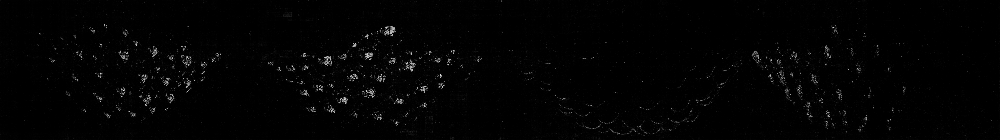

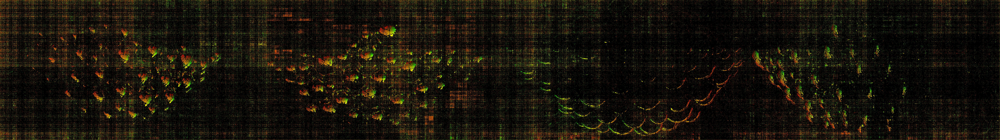

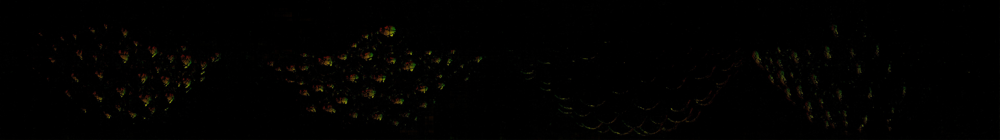

CPU times: user 2.39 s, sys: 910 ms, total: 3.3 s
Wall time: 3.25 s
store
CPU times: user 5.06 s, sys: 560 ms, total: 5.62 s
Wall time: 8.1 s
scan-2338
load
List images, loading and pre-processing now
Pre-processing finished
Horizontal count: 11
Vertical count: 13
CPU times: user 4.88 s, sys: 42.4 s, total: 47.2 s
Wall time: 1min 27s
calculate diff
CPU times: user 2.63 s, sys: 7.32 s, total: 9.95 s
Wall time: 10 s
run pack
CPU times: user 1.44 s, sys: 1.86 s, total: 3.3 s
Wall time: 3.32 s
build promap
CPU times: user 690 ms, sys: 360 ms, total: 1.05 s
Wall time: 1.05 s


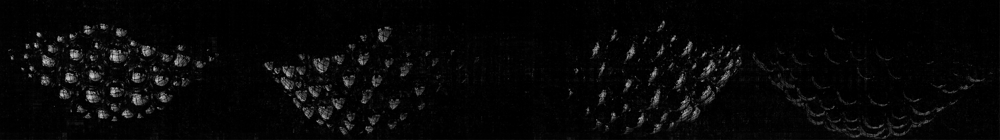

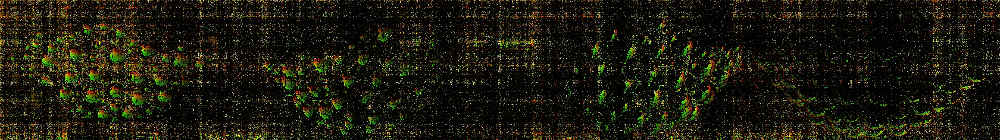

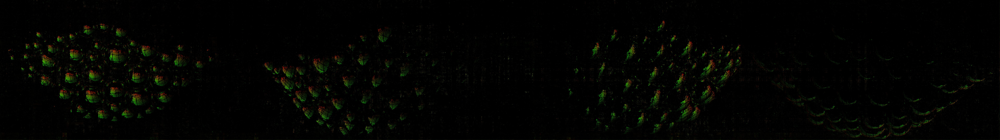

CPU times: user 1.39 s, sys: 370 ms, total: 1.76 s
Wall time: 1.75 s
store
CPU times: user 5.01 s, sys: 630 ms, total: 5.64 s
Wall time: 7.85 s
scan-2346
load
List images, loading and pre-processing now
Pre-processing finished
Horizontal count: 11
Vertical count: 13
CPU times: user 3 s, sys: 20.3 s, total: 23.3 s
Wall time: 1min 14s
calculate diff
CPU times: user 2.34 s, sys: 5.97 s, total: 8.31 s
Wall time: 8.34 s
run pack
CPU times: user 1.44 s, sys: 1.11 s, total: 2.55 s
Wall time: 2.55 s
build promap
CPU times: user 540 ms, sys: 360 ms, total: 900 ms
Wall time: 909 ms


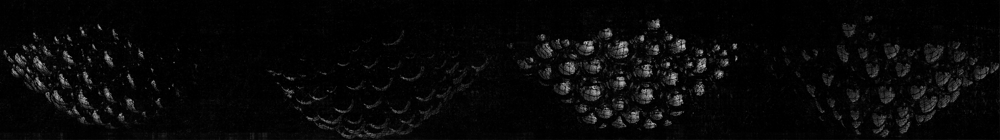

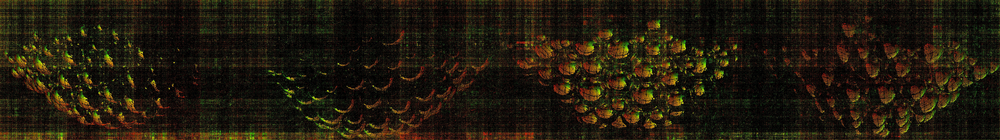

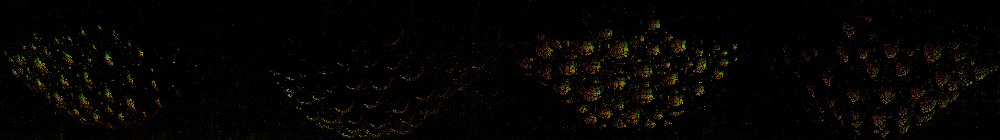

CPU times: user 1.58 s, sys: 480 ms, total: 2.06 s
Wall time: 2.06 s
store
CPU times: user 5.16 s, sys: 540 ms, total: 5.7 s
Wall time: 7.58 s
scan-2357
load
List images, loading and pre-processing now
Pre-processing finished
Horizontal count: 11
Vertical count: 13
CPU times: user 6.29 s, sys: 58.7 s, total: 1min 4s
Wall time: 1min 44s
calculate diff
CPU times: user 2.61 s, sys: 7.98 s, total: 10.6 s
Wall time: 10.6 s
run pack
CPU times: user 1.7 s, sys: 1.27 s, total: 2.97 s
Wall time: 2.96 s
build promap
CPU times: user 670 ms, sys: 250 ms, total: 920 ms
Wall time: 926 ms


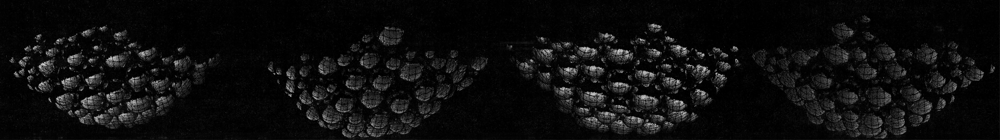

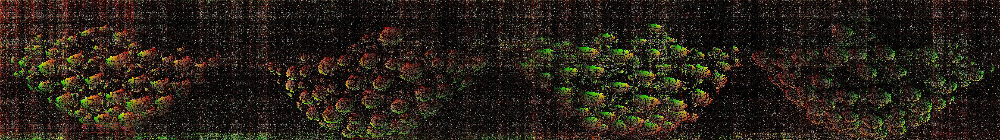

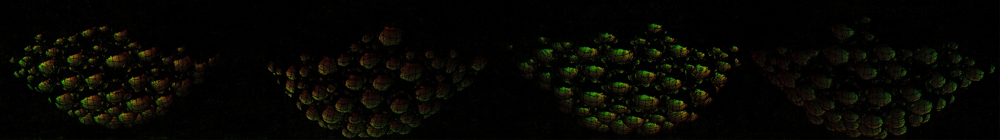

CPU times: user 1.32 s, sys: 420 ms, total: 1.74 s
Wall time: 1.73 s
store
CPU times: user 6.25 s, sys: 590 ms, total: 6.84 s
Wall time: 9.16 s
scan-2358
load
List images, loading and pre-processing now
Pre-processing finished
Horizontal count: 11
Vertical count: 13
CPU times: user 3.65 s, sys: 32 s, total: 35.7 s
Wall time: 1min 15s
calculate diff
CPU times: user 2.47 s, sys: 5.88 s, total: 8.35 s
Wall time: 8.34 s
run pack
CPU times: user 1.53 s, sys: 1.02 s, total: 2.55 s
Wall time: 2.56 s
build promap
CPU times: user 630 ms, sys: 220 ms, total: 850 ms
Wall time: 844 ms


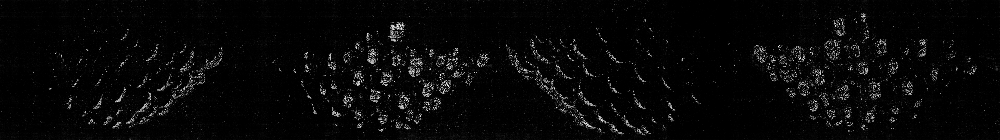

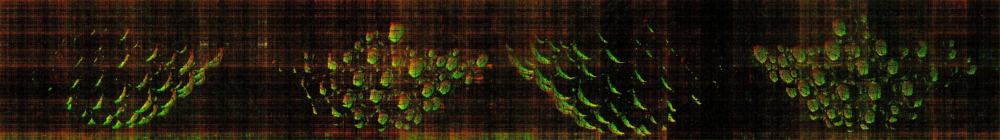

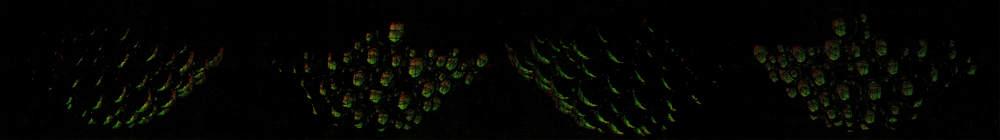

CPU times: user 1.17 s, sys: 490 ms, total: 1.66 s
Wall time: 1.64 s
store
CPU times: user 5.77 s, sys: 670 ms, total: 6.44 s
Wall time: 8.64 s


In [25]:
import re
folders = sorted([f for f in os.listdir(data_dir) if re.match(r'^scan-23', f)])
print(folders)
folders = folders[1:] 
# folders = ['scan-1853']
print(folders)
# asdasd
for folder in folders:
    try:
        print(folder)
        print('load')
        %time load_scan(folder)
        print('calculate diff')
        %time calculate_difference()
        print('run pack')
        %time run_pack()
        print('build promap')
        %time run_build_promap()
        %time render_result()
        print('store')
        %time store_results(folder)
    except: 
        print("Had to cancel ",folder)

In [168]:
%matplotlib inline


sync_data()
# #Download data
# procams_folder = '/tmp/procams/'
# # !rm -rf {procams_folder}
# !mkdir -p {procams_folder}
# # !gsutil -m cp -r gs://{bucket}/processedScans/* {procams_folder}
# !gsutil -m rsync -r gs://{bucket}/ {procams_folder}
!ls {data_dir}

Building synchronization state...
Starting synchronization...
BuildXYZDebug.png    model.dae	scan-1512  scan-1529  settings.json
confidenceMap-0.exr  scan-1249	scan-1515  scan-1534  shader
_mask-0.png	     scan-1255	scan-1521  scan-1539  SharedData
mask-0.png	     scan-1338	scan-1524  scan-1541  xyzMap-0.exr


In [88]:
def loadScan(name):
  print("Process",name)
#   print(os.path.join(data_dir, name, 'proMap-python.png'))
  proMap = imread(os.path.join(data_dir, name, 'proMap-python.png'))[:, :, :2]
  proConfidence = imread(os.path.join(data_dir, name, 'proConfidence-python.exr'))
#   proMap = imread(os.path.join(data_dir, name, 'proMap.png'))[:, :, :2]
#   proConfidence = imread(os.path.join(data_dir, name, 'proConfidence.exr'))
  xyzMap = imread(os.path.join(data_dir, name, 'xyzMap.exr'))
  scale = 4
  try:
    scale = images[0][0].shape[0] / xyzMap.shape[0]
  except NameError:
    print("Using hardcoded scale",scale)

  xyzMap = upsample(xyzMap, scale=scale)
  return (proMap, proConfidence, xyzMap)
  

proMaps = []
proConfidences = []
xyzMaps = []


# folders = os.listdir(data_dir)
folders = [
    "scan-0000",
    
]
for folder in folders:
#   try:
    (proMap, proConfidence, xyzMap) = loadScan(folder)
    proMaps.append(proMap)
    proConfidences.append(proConfidence)
    xyzMaps.append(xyzMap)
#   except:
#     print("Could not load ",folder)
  
proMaps = np.asarray(proMaps)
proConfidences = np.asarray(proConfidences)
xyzMaps = np.asarray(xyzMaps)

print(proMaps.shape)
print(proConfidences.shape)
  

Process scan-0000
(1, 1080, 7680, 2)
(1, 1080, 7680)


In [89]:
# print(np.dstack((proMaps[0], np.zeros(proMaps[0].shape[0], proMaps[0].shape[1]) )).shape)
# plt.imshow(proMap[1])
# mpld3.display()


Text(0.5, 1.0, 'Confidence thresholded')

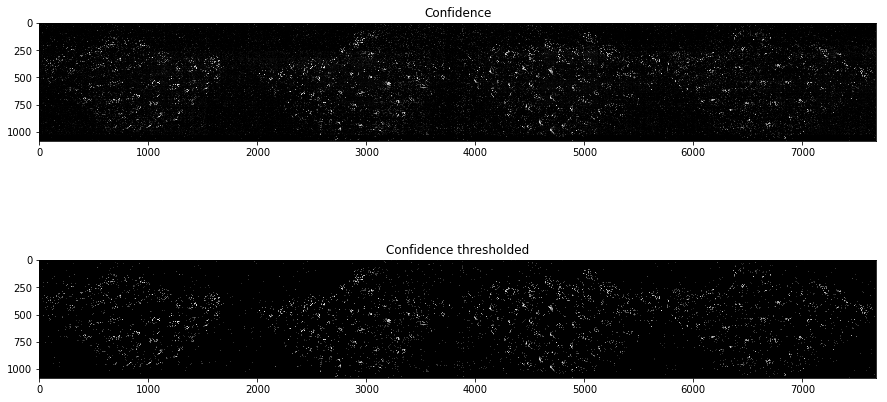

In [90]:
confidence_threshold = 0.1 #@param

proConfidencesThresholded = proConfidences.copy()
mask = proConfidencesThresholded > confidence_threshold
proConfidencesThresholded[ mask == 0 ] = 0


fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(15, 8), sharey=True)
ax1.imshow(proConfidences.mean(axis=0), cmap='gray')
ax1.set_title('Confidence')

ax2.imshow(proConfidencesThresholded.mean(axis=0), cmap='gray')
ax2.set_title('Confidence thresholded')

  
# mpld3.display()

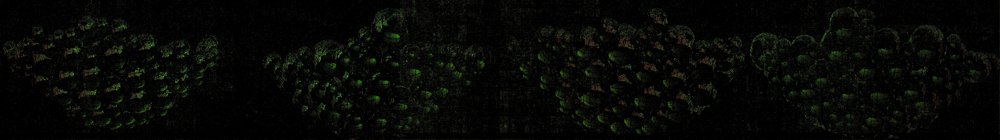

In [92]:
# print(xyzMaps.shape)
num_scans = xyzMaps.shape[0]

xyzFlat = xyzMaps.reshape(( -1, 3))

x = proMaps[:,:,:, 0].reshape((-1))
y = proMaps[:,:,:, 1].reshape((-1))
z = np.indices(proMaps.shape[0:3])[0].reshape((-1))
# print(z[0])


assert x.max() == xyzMaps.shape[2] - 1
assert y.max() == xyzMaps.shape[1] - 1

lut_indexes = np.ravel_multi_index((z, y, x), xyzMaps.shape[0:3], order="C")
# lut_indexes_reshaped = lut_indexes.reshape((num_scans, -1))

# plt.plot(lut_indexes)
# print(lut_indexes.max())

proXyzMaps = xyzFlat[lut_indexes]

proXyzMaps = proXyzMaps.reshape((num_scans, proMaps.shape[1], -1, 3))

# plt.imshow(proXyzMap[1])

# print("Max: ")
# print(proXyzMaps.max(axis=(1,2)))
# print("Min: ")
# print(proXyzMaps.min(axis=(1,2)))

proXyzMapsThresholded = proXyzMaps * (proConfidences[:,:,:,np.newaxis] > confidence_threshold)

for a in proXyzMapsThresholded:
      imshow(a * (256/proXyzMapsThresholded.max()), zoom=0.1, fmt='jpg')
# mpld3.display()

In [93]:
from scipy.spatial import distance

meanPoint = np.mean(xyzMaps, axis=(1,2))
print("Mean point", meanPoint)

distances = np.zeros(proXyzMaps.shape[0:3])[:,:,:,np.newaxis]

for i, proXyzMap in enumerate(proXyzMapsThresholded):
  xyzFlat = proXyzMap.reshape((-1, 3))
  d = distance.cdist(xyzFlat, [meanPoint[i]])
  d = d.reshape((proXyzMaps.shape[1], proXyzMaps.shape[2], 1))
  distances[i] = d
  

# fig, ax = plt.subplots(nrows=num_scans, ncols=1, figsize=(30, 10), sharey=True)
# for i, distance in enumerate(distances):
#   ax[i].imshow(-distance[:,:,0], cmap='jet')

# plt.show()

Mean point [[0.25220504 0.47130203 0.05398171]]


(1, 1080, 7680, 1) (1, 1080, 7680, 3) (8294400,) (8294400, 1, 3)


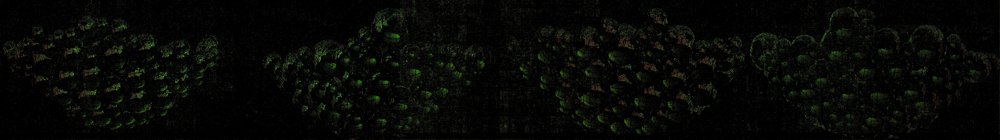

In [95]:
dominant_scans_index = np.argmin(distances, axis=0).reshape(-1)

transposed = proXyzMapsThresholded.transpose((1,2,0,3)).reshape((-1, num_scans, 3))

print(distances.shape, proXyzMapsThresholded.shape, dominant_scans_index.shape, transposed.shape)

proXyzMapCombined = transposed[range(transposed.shape[0]), dominant_scans_index].reshape(proXyzMapsThresholded[0,:,:].shape)

imshow(proXyzMapCombined* (256/proXyzMapsThresholded.max()), zoom=0.3, fmt="jpg")

In [96]:
# validation_image = imread('/tmp/data/todaysart/xyzMap-0.exr')
# imshow(validation_image * (256/proXyzMapsThresholded.max()), zoom=0.3, fmt="jpg")

TypeError: unsupported operand type(s) for *: 'NoneType' and 'float'

# Build XYZ V2
## Load

In [6]:
sync_data()
!ls {data_dir}

 confidenceMap-0.exr	      _scan-0022      scan-1822    _scan-2110
 confidenceMap-python-0.exr   _scan-0027      scan-1827    _scan-2115
 mask-0.png		      _scan-0031      scan-1831    settings.json
 model.dae		     '_scan-0031 2'   scan-1836    shader
 _scan-0000		      _scan-0034      _scan-1842   xyzMap-0.exr
 _scan-0012		      _scan-0048      scan-1848    xyzMap-python-0.exr
 _scan-0015		      _scan-0051      scan-1853
 _scan-0018		      _scan-0057      scan-1858


In [8]:
def loadScan(name):
    print("Process",name)
    xyzMap = imread(os.path.join(data_dir, name, 'xyzMap.exr'))
    camBinary = np.load(os.path.join(data_dir, name, 'camBinary-python.npy'))
    camConfidence = imread(os.path.join(data_dir, name, 'camConfidence-python.exr'))
    scale = camBinary.shape[0] / xyzMap.shape[0]

    xyzMap = upsample(xyzMap, scale=scale)
    return (camBinary, camConfidence, xyzMap)


camBinaries = []
xyzMaps = []
camConfidences = []


# folders = os.listdir(data_dir)
folders = [
    "scan-1822",
    "scan-1827",
#     "scan-1831",
#     "scan-1836",
# #     "scan-1842",
#     "scan-1848",
#     "scan-1853",
#     "scan-1858",
    
#     "scan-2319",
#     "scan-2329",
#     "scan-2338",
#     "scan-2346",
#     "scan-2357",
#     "scan-2358"
#     "scan-18",
    
#     "scan-1515",
#     "scan-1521",
#     "scan-1524",
#     "scan-1529",
#     "scan-1534",
#     "scan-1539",
#     "scan-1541",
#     "scan-2137",
#     "scan-2201",
#     "scan-2207",
#     "scan-2210",
#     "scan-2214",
#     "scan-2218",
#     "scan-2222",
#     "scan-1539",
#     "scan-1539",
]
for folder in folders:
#   try:
    (camBinary, camConfidence, xyzMap) = loadScan(folder)
    camBinaries.append(camBinary)
    camConfidences.append(camConfidence)
    xyzMaps.append(xyzMap)
#   except:
#     print("Could not load ",folder)
  
camBinaries = np.asarray(camBinaries)
xyzMaps = np.asarray(xyzMaps)
camConfidences = np.asarray(camConfidences)

print(camBinaries.shape)
print(camConfidences.shape)
print(xyzMaps.shape)

Process scan-1822
Process scan-1827
(2, 3456, 5184, 2)
(2, 3456, 5184)
(2, 3456, 5184, 3)


In [13]:
sys.getsizeof(xyzMaps)

ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True)

[('stack', 3726508176),
 ('xyzMaps', 2794881168),
 ('xyzMap', 214990976),
 ('camBinary', 71663744),
 ('camConfidence', 71663728),
 ('job_wrapper', 1056),
 ('BytesIO', 400),
 ('product', 400),
 ('timedelta', 400),
 ('folders', 168),
 ('clear_output', 136),
 ('downsample', 136),
 ('imread', 136),
 ('imresize', 136),
 ('imshow', 136),
 ('imwrite', 136),
 ('jit', 136),
 ('loadScan', 136),
 ('progress', 136),
 ('progress_parallel', 136),
 ('rb_swap', 136),
 ('sync_data', 136),
 ('to_single_gray', 136),
 ('to_single_rgb', 136),
 ('upsample', 136),
 ('camProjIndex', 128),
 ('binaryFlat', 112),
 ('ndimage', 80),
 ('np', 80),
 ('plt', 80),
 ('data_dir', 72),
 ('Pool', 64),
 ('cpu_count', 64),
 ('bucket', 59),
 ('bucket_folder', 58),
 ('folder', 58),
 ('LOCAL', 28),
 ('proj_height', 28),
 ('proj_width', 28)]

## Stack and sort

In [16]:
# camConfidences, camBinaries, worldXyzMaps
# Calculate proj index
print(1)

# Decodede binary array x y positions
binaryFlat = camBinaries.reshape(( -1, 2))

print(2)
# Overflow fix
binaryFlat[(binaryFlat[:,0] >= proj_width) | (binaryFlat[:,1] >= proj_height)] = [0,0]

print(3)
# Calculate 1d position index in projector space
camProjIndex = np.ravel_multi_index(binaryFlat.transpose()[::-1], (proj_height, proj_width), order="C")

# Reshape into top level number of scans
camProjIndex = camProjIndex.reshape(camBinaries.shape[0:3])

# print(4)
# # print("max", camProjIndex.max())
# # print(camProjIndex.shape, camConfidences.shape, worldXyzMaps.shape)
# # Stack proj index with confidence 

# print(5)

# Stack confidence and index on last axis
stack = np.stack((camConfidences, camProjIndex), axis=-1)


# # print(stack.shape, worldXyzMaps.shape)

# Add xyzMap to stack (0: confidence, 1: projector space index, 2-4: xyz position)
stack = np.vstack((stack.transpose(), xyzMaps.transpose())).transpose()
# # print(stack)

# print(7)
flatStack = stack.reshape(-1, stack.shape[-1])

# print(8)
# Sort on confidence
# sortedStack = flatStack[flatStack[:,0].argsort()[::-1]]
print(flatStack[:,0].shape)
topStack = flatStack[flatStack[:,0].argmax()]

print("Done")
print(topStack.shape)

1
2
3
(35831808,)
Done
(5,)


In [10]:
# del camConfidences
# del camBinaries
# del xyzMap
# del camBinary

print(flatStack[:,0].shape)
topStack = flatStack[flatStack[:,0].argmax()]

print("Done")
print(topStack.shape)

print(sortedStack.shape)


(35831808, 5)


In [ ]:
print(sortedStack.transpose()[1].shape)

# Find what projector space indexes are represented, and where the first is (highest confidence)
%time (u, indexes,  counts) = np.unique(sortedStack.transpose()[1].astype(np.uint32), return_index=True, return_counts=True, return_inverse=False)
print(u, indexes)

## Combine

In [10]:
projMask = imread(os.path.join(data_dir, 'mask-0.png')).mean(axis=2) / 255

In [11]:
# print(sortedStack.transpose()[1].astype(np.uint32).shape, u.shape)
# filtered_u = u[(u[:,0] < proj_width) & (u[:,1] < proj_height)]
# filtered_counts = counts[(u[:,0] < proj_width) & (u[:,1] < proj_height)]
# filtered_indexes = indexes[(u[:,0] < proj_width) & (u[:,1] < proj_height)]

# uu = filtered_u.transpose()[::-1]

# print(uu[::-1])
# print(uu, (proj_height, proj_width))
# lut_u = np.ravel_multi_index(uu, (proj_height, proj_width), order="C")
# print(lut_indexes)

# Initialize projector output map
counts[0] = 0
pro = np.zeros((proj_height, proj_width, 3))
proConfidence = np.zeros((proj_height, proj_width, 1))

print(sortedStack[indexes][:,2:].shape)

# Grab top ranking xyz from sorted stack
pro.reshape(-1, 3)[u] = sortedStack[indexes][:,2:]
proConfidence.reshape(-1)[u] = sortedStack[indexes][:,0]
# print(pro.mean())
# print(camProjIndex.max())

# print(filtered_counts)

# pro[proConfidence < 0.1] = [0,0,0]
# show_array( pro / pro.max() * 255  , zoom=0.5)
# show_array(proConfidence * 128, zoom=0.5)
# show_array(pro / pro.max() * 255  , zoom=0.3)


(6371266, 3)


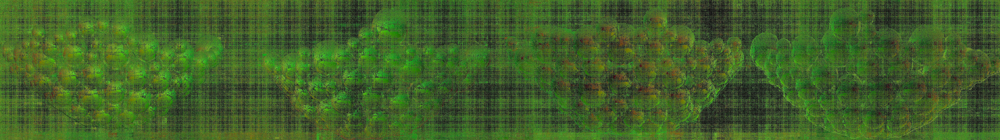

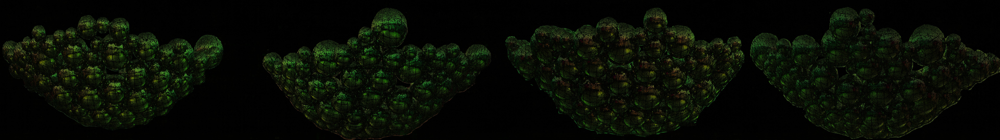

In [12]:
proConfidenceMasked = proConfidence * projMask[:,:,np.newaxis]
imshow(pro / pro.max() * 255, zoom=1.0, fmt='jpg')
imshow(proConfidence * pro / (proConfidence * pro).max() * 255  * projMask[:,:,np.newaxis], zoom=1.0, fmt='jpg')


## Store



In [13]:
# print(pro.dtype,  proConfidenceMasked[:,:,0].shape)
# 
imwrite('../SharedData/xyzMap-0.exr', pro.astype(np.float32))
imwrite('../SharedData/confidenceMap-0.exr', proConfidenceMasked.astype(np.float32))

if not LOCAL:
    !gsutil cp ../SharedData/xyzMap-python-0.exr gs://{bucket}/{bucket_folder}/
    !gsutil cp ../SharedData/confidenceMap-python-0.exr gs://{bucket}/{bucket_folder}/


In [167]:
# print(filtered_indexes.shape, filtered_u.shape)

# # lut_indexes = np.ravel_multi_index(uu, (proj_height, proj_width), order="C")
# pro = np.zeros((proj_height, proj_width, 3))
# print(pro.reshape(-1)[lut_u].shape)
# pos = worldXyzMaps[filtered_indexes]
# # print(pos.shape)
# pro.reshape(-1, 3)[lut_u] = pos  

# show_array(pro / pro.max() * 256, zoom=0.3)

